<a href="https://colab.research.google.com/github/Eitan177/Bulk-Bing-Image-downloader/blob/master/similar_image_search.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Similarity Search Using Keywords and Reference Image
### 1) First Code Cell Searches Unknowns Site Using Key Words
### 2) Seconde Code Cell Uploads an Image
### 3) Third Code Cell Rearranges the images based on similarity to uploaded image




searching site http://apps.pathology.jhu.edu/sp/ for melanoma
./Bulk-Bing-Image-downloader/bbid.py -s "melanoma site:http://apps.pathology.jhu.edu/sp/" --limit 100 -o downloadedimages
0
http://apps.pathology.jhu.edu/sp/tag/recurrent-non-small-cell-carcinoma http://apps.pathology.jhu.edu/sp/week-1-case-1-3188/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/ http://apps.pathology.jhu.edu/sp/week-644-case-1/


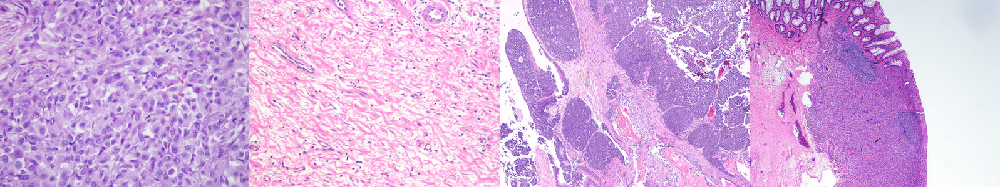

4
http://apps.pathology.jhu.edu/sp/week-1-case-1-1982/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/ http://apps.pathology.jhu.edu/sp/week-1-case-1-51/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/


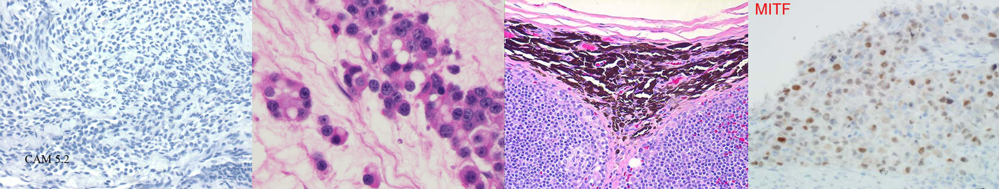

8
http://apps.pathology.jhu.edu/sp/week-680-case-2/ http://apps.pathology.jhu.edu/sp/week-671-case-1/ http://apps.pathology.jhu.edu/sp/week-652-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-51/


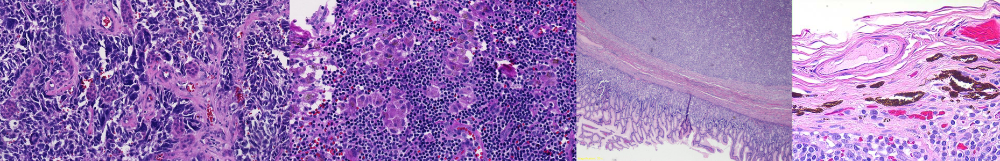

12
http://apps.pathology.jhu.edu/sp/week-1-case-1-2/ http://apps.pathology.jhu.edu/sp/week-671-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-26/ http://apps.pathology.jhu.edu/sp/week-671-case-1/


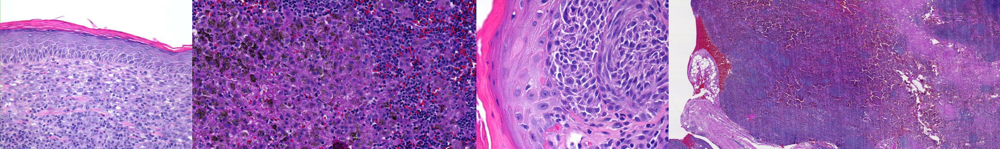

16
http://apps.pathology.jhu.edu/sp/week-669-case-3/ http://apps.pathology.jhu.edu/sp/week-635-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-4/ http://apps.pathology.jhu.edu/sp/week-686-case-2/


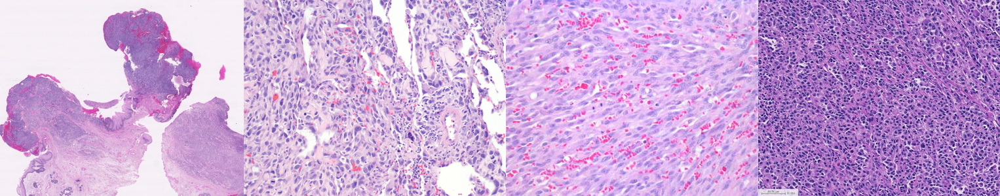

20
http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/ http://apps.pathology.jhu.edu/sp/week-692-case-1/ http://apps.pathology.jhu.edu/sp/week-675-case-3/ http://apps.pathology.jhu.edu/sp/tag/metastatic-melanoma


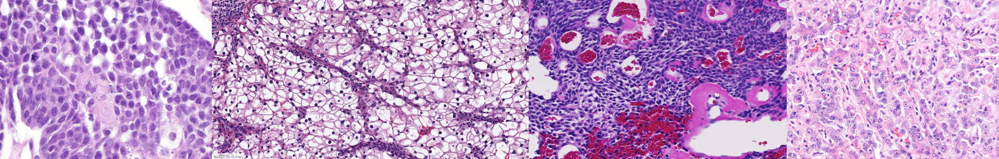

24
http://apps.pathology.jhu.edu/sp/week-1-case-1-2695/ http://apps.pathology.jhu.edu/sp/week-628-case-2/ http://apps.pathology.jhu.edu/sp/week-686-case-3/ http://apps.pathology.jhu.edu/sp/week-690-case-1/


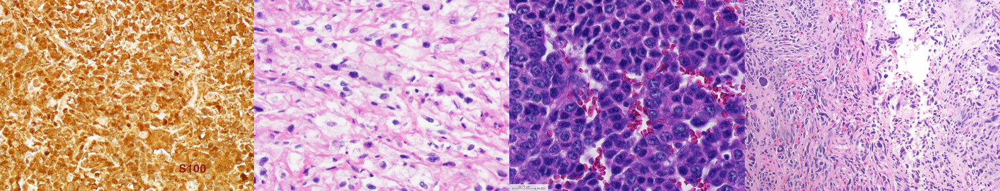

28
http://apps.pathology.jhu.edu/sp/week-702-case-1/ http://apps.pathology.jhu.edu/sp/week-659-case-3/ http://apps.pathology.jhu.edu/sp/week-644-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-1954/


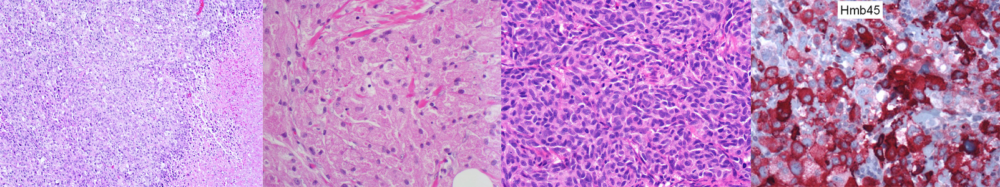

32
http://apps.pathology.jhu.edu/sp/week-1-case-1-3060/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3075/ http://apps.pathology.jhu.edu/sp/week-680-case-2/ http://apps.pathology.jhu.edu/sp/week-1-case-1-1982/


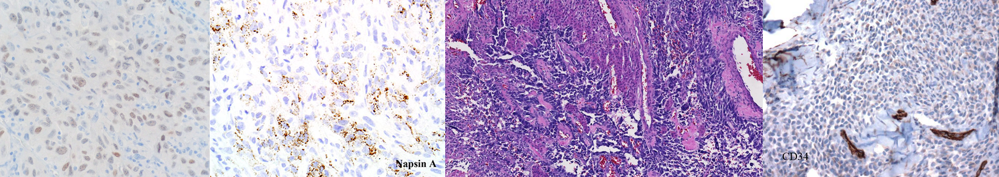

36
http://apps.pathology.jhu.edu/sp/week-702-case-1/ http://apps.pathology.jhu.edu/sp/week-644-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-669-case-3/


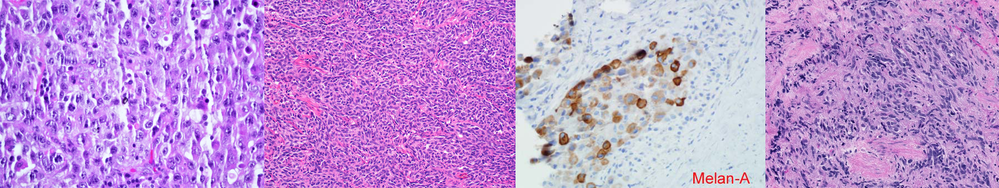

40
http://apps.pathology.jhu.edu/sp/author/rjone111/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2035/ http://apps.pathology.jhu.edu/sp/author/ksalimi1/ http://apps.pathology.jhu.edu/sp/week-680-case-2/


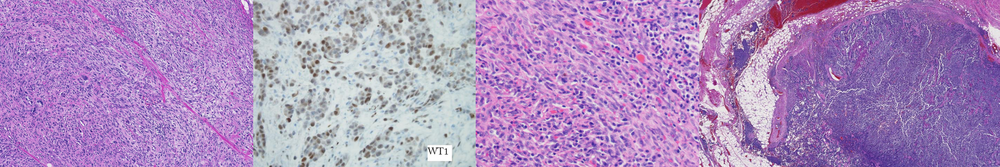

44
http://apps.pathology.jhu.edu/sp/week-1-case-1-26/ http://apps.pathology.jhu.edu/sp/week-680-case-2/ http://apps.pathology.jhu.edu/sp/week-635-case-2-2/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/


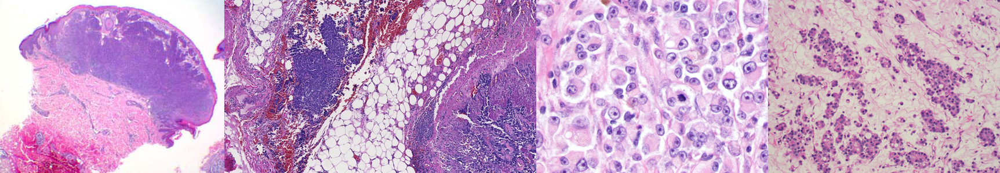

48
http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/ http://apps.pathology.jhu.edu/sp/week-659-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3188/ http://apps.pathology.jhu.edu/sp/week-1-case-1-26/


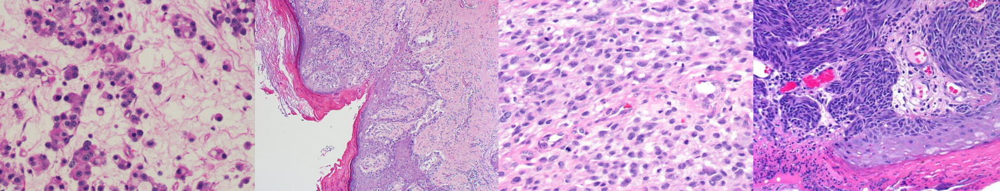

52
http://apps.pathology.jhu.edu/sp/week-1-case-1-2695/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-51/ http://apps.pathology.jhu.edu/sp/week-690-case-1/


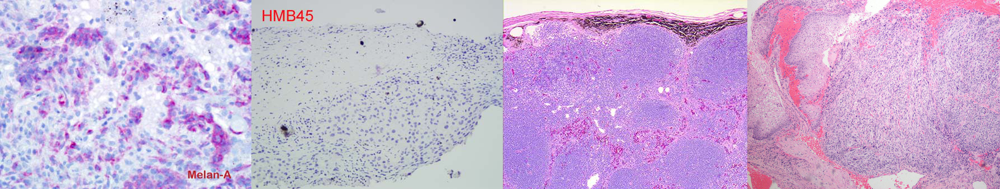

56
http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2703/ http://apps.pathology.jhu.edu/sp/tag/clear-cell-sarcoma http://apps.pathology.jhu.edu/sp/week-702-case-1/


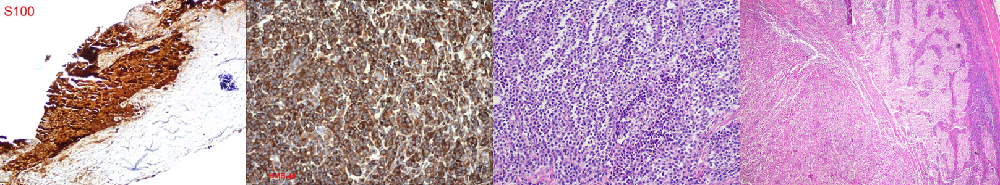

60
http://apps.pathology.jhu.edu/sp/week-637-case-3/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2563/ http://apps.pathology.jhu.edu/sp/week-659-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/


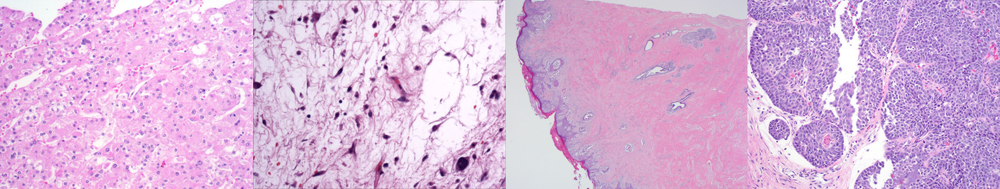

In [12]:
#@title 1) First Code Cell: Image Search Using Keywords

%reload_ext autoreload
%autoreload 2
%matplotlib inline

from os import path
import pickle
import subprocess
import IPython.display as display
from PIL import Image
import shutil
import PIL
import time
import os

if path.exists('./downloadedimages'):
  shutil.rmtree('./downloadedimages')
if os.path.exists('./url.dictionary'):
  os.remove('./url.dictionary')

search = 'melanoma' #@param {type:"string"}
site = 'http://apps.pathology.jhu.edu/sp/' #@param ["http://apps.pathology.jhu.edu/sp/", "https://www.pathologyoutlines.com/"]

print('searching site', site,'for',search)

if not path.exists('./Bulk-Bing-Image-downloader/'):
  !git clone https://github.com/Eitan177/Bulk-Bing-Image-downloader/

strforbash= './Bulk-Bing-Image-downloader/bbid.py -s ' +'"'+search+ ' site:'+site+'"'+' --limit 100 -o downloadedimages'

print(strforbash)

def bash_command(cmd):
    subprocess.Popen(cmd, shell=True, executable='/bin/bash')

bash_command(strforbash)


def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst


def display_imgs(vector_of_img_paths):
  for index,image_path in enumerate(vector_of_img_paths):
    baseheight=300
    if index % 4 == 0 and index<(len(vector_of_img_paths)-3):
      print(index)
      img0=Image.open(str(image_path))
      path, file0 = os.path.split(image_path)
      title0=url_dictionary[file0]
      
      img1=Image.open(str(vector_of_img_paths[index+1]))
      path, file1 = os.path.split(vector_of_img_paths[index+1])
      title1=url_dictionary[file1]
      
      img2=Image.open(str(vector_of_img_paths[index+2]))
      path, file2 = os.path.split(vector_of_img_paths[index+2])
      title2=url_dictionary[file2]
 
      img3=Image.open(str(vector_of_img_paths[index+3]))
      path, file3 = os.path.split(vector_of_img_paths[index+3])
      title3=url_dictionary[file3]
      
      hpercent0 = (baseheight / float(img0.size[1]))
      hpercent1 = (baseheight / float(img1.size[1]))
      hpercent2 = (baseheight / float(img2.size[1]))
      hpercent3 = (baseheight / float(img3.size[1]))

      wsize0 = int((float(img0.size[0]) * float(hpercent0)))  
      wsize1 = int((float(img1.size[0]) * float(hpercent1)))    
      wsize2 = int((float(img2.size[0]) * float(hpercent2)))    
      wsize3 = int((float(img3.size[0]) * float(hpercent3)))    
      
      img0 = img0.resize((wsize0, baseheight), PIL.Image.ANTIALIAS)
      img1 = img1.resize((wsize1, baseheight), PIL.Image.ANTIALIAS)
      img2 = img2.resize((wsize2, baseheight), PIL.Image.ANTIALIAS)
      img3 = img3.resize((wsize3, baseheight), PIL.Image.ANTIALIAS)
  
      print(title0+' '+title1+' '+title2+' '+title3)
      display.display(get_concat_h(get_concat_h(img0,img1),get_concat_h(img2,img3)))
    



import glob
image_paths = []
image_classes = ['downloadedimages']
while not os.path.exists('./url.dictionary'):
  time.sleep(10)

with open('url.dictionary', 'rb') as url_dictionary_file:
    url_dictionary = pickle.load(url_dictionary_file)


for image_class in image_classes:
  image_paths.extend(glob.glob('/content/' + image_class + '/*'))


display_imgs(image_paths)


In [10]:
#@title 2) Upload Image

from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(name=fn, length=len(uploaded[fn])))


Saving 52-1024x768.jpg to 52-1024x768.jpg
User uploaded file "52-1024x768.jpg" with length 175558 bytes


  Cloning git://github.com/jaredwinick/img2vec-keras.git to /tmp/pip-req-build-uipab9yp
  Running command git clone -q git://github.com/jaredwinick/img2vec-keras.git /tmp/pip-req-build-uipab9yp
  Created wheel for img2vec-keras: filename=img2vec_keras-0.2-cp36-none-any.whl size=6203 sha256=35cc365088c07d2e5cb007be9f46f31470bf24e7da818105a7de7a72408f6b9d
  Stored in directory: /tmp/pip-ephem-wheel-cache-ilefy688/wheels/2e/90/3e/18022740db56735624f1fa778b670e7c013bbf4e9b1802e764
Successfully built img2vec-keras
0
Uploaded from file                   http://apps.pathology.jhu.edu/sp/week-686-case-3/ http://apps.pathology.jhu.edu/sp/week-635-case-2-2/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3188/


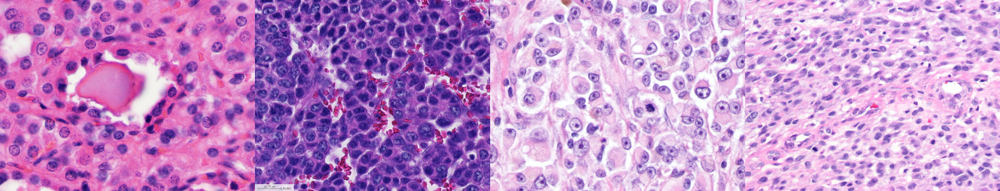

4
http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/ http://apps.pathology.jhu.edu/sp/week-675-case-3/ http://apps.pathology.jhu.edu/sp/week-628-case-2/


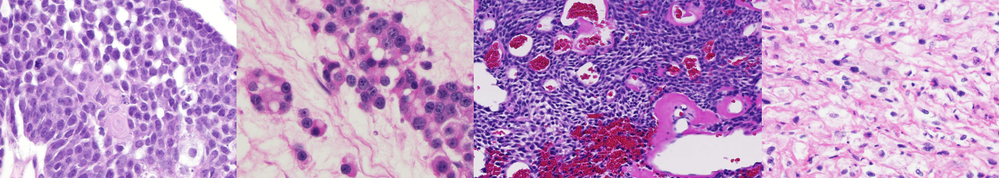

8
http://apps.pathology.jhu.edu/sp/week-1-case-1-26/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/ http://apps.pathology.jhu.edu/sp/week-644-case-1/ http://apps.pathology.jhu.edu/sp/week-637-case-3/


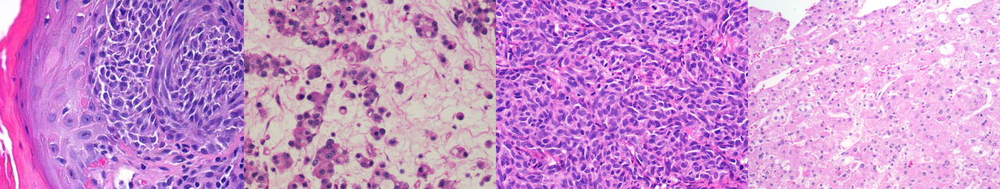

12
http://apps.pathology.jhu.edu/sp/tag/metastatic-melanoma http://apps.pathology.jhu.edu/sp/tag/recurrent-non-small-cell-carcinoma http://apps.pathology.jhu.edu/sp/week-659-case-3/ http://apps.pathology.jhu.edu/sp/week-1-case-1-26/


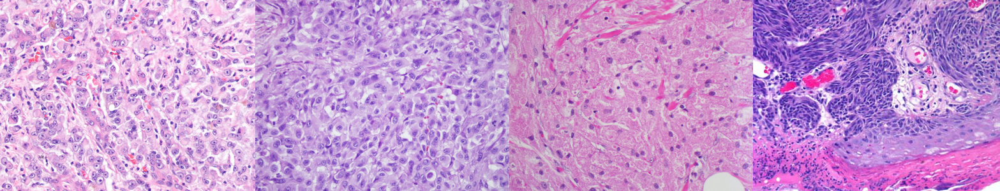

16
http://apps.pathology.jhu.edu/sp/week-1-case-1-1954/ http://apps.pathology.jhu.edu/sp/week-1-case-1-51/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2/ http://apps.pathology.jhu.edu/sp/week-1-case-1-4/


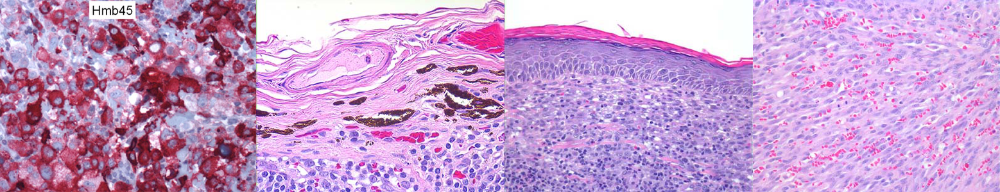

20
http://apps.pathology.jhu.edu/sp/week-1-case-1-2695/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-51/ http://apps.pathology.jhu.edu/sp/week-702-case-1/


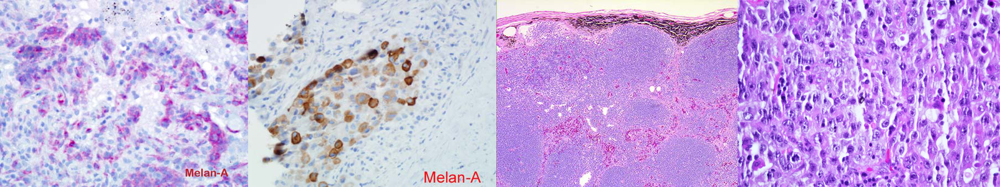

24
http://apps.pathology.jhu.edu/sp/week-1-case-1-51/ http://apps.pathology.jhu.edu/sp/week-690-case-1/ http://apps.pathology.jhu.edu/sp/week-644-case-1/ http://apps.pathology.jhu.edu/sp/week-659-case-1/


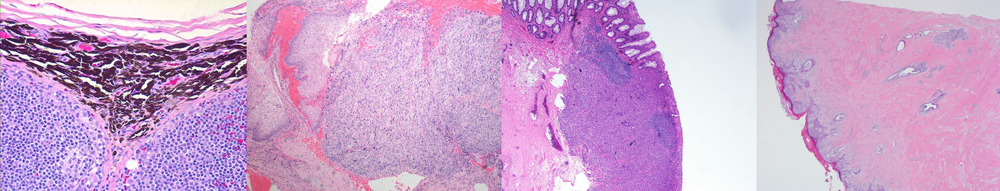

28
http://apps.pathology.jhu.edu/sp/author/ksalimi1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/ http://apps.pathology.jhu.edu/sp/tag/clear-cell-sarcoma http://apps.pathology.jhu.edu/sp/week-702-case-1/


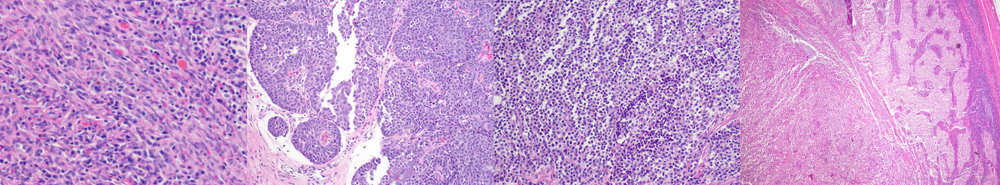

32
http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3188/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3060/ http://apps.pathology.jhu.edu/sp/week-1-case-1-26/


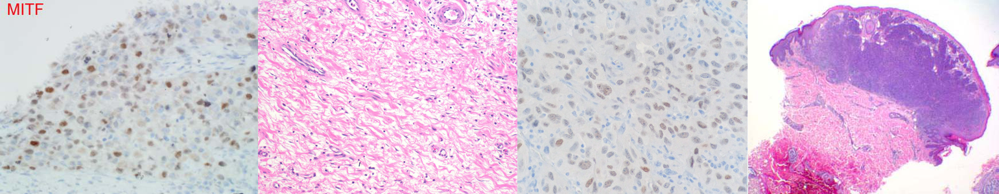

36
http://apps.pathology.jhu.edu/sp/week-1-case-1-1982/ http://apps.pathology.jhu.edu/sp/week-671-case-1/ http://apps.pathology.jhu.edu/sp/week-659-case-1/ http://apps.pathology.jhu.edu/sp/week-635-case-1/


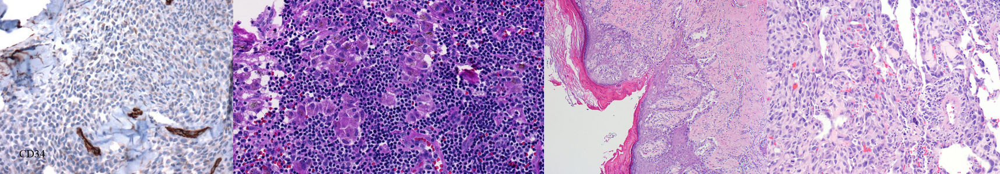

40
http://apps.pathology.jhu.edu/sp/week-644-case-1/ http://apps.pathology.jhu.edu/sp/week-669-case-3/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3142/ http://apps.pathology.jhu.edu/sp/week-671-case-1/


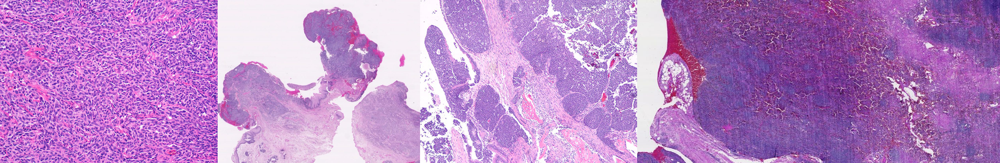

44
http://apps.pathology.jhu.edu/sp/week-680-case-2/ http://apps.pathology.jhu.edu/sp/week-652-case-1/ http://apps.pathology.jhu.edu/sp/week-680-case-2/ http://apps.pathology.jhu.edu/sp/week-680-case-2/


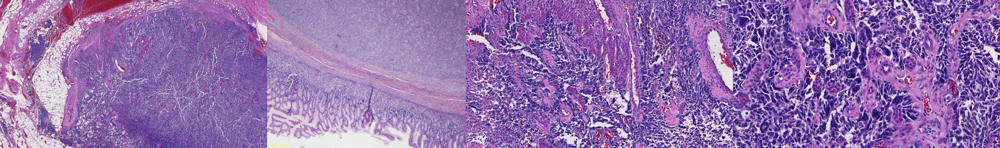

48
http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-3177/ http://apps.pathology.jhu.edu/sp/week-671-case-1/ http://apps.pathology.jhu.edu/sp/week-690-case-1/


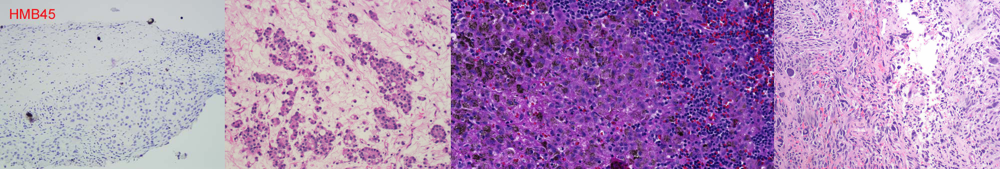

52
http://apps.pathology.jhu.edu/sp/week-669-case-3/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2563/ http://apps.pathology.jhu.edu/sp/week-692-case-1/ http://apps.pathology.jhu.edu/sp/week-680-case-2/


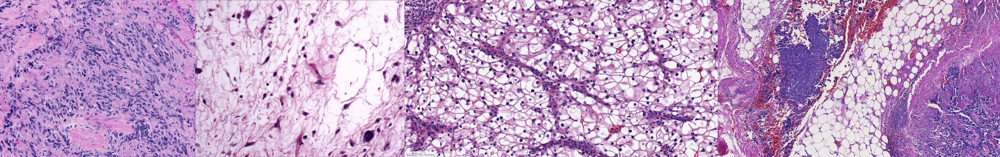

56
http://apps.pathology.jhu.edu/sp/week-1-case-1-2668/ http://apps.pathology.jhu.edu/sp/week-1-case-1-1982/ http://apps.pathology.jhu.edu/sp/author/rjone111/ http://apps.pathology.jhu.edu/sp/week-686-case-2/


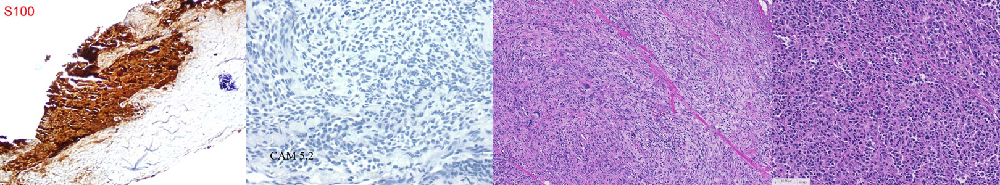

60
http://apps.pathology.jhu.edu/sp/week-1-case-1-3075/ http://apps.pathology.jhu.edu/sp/week-702-case-1/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2035/ http://apps.pathology.jhu.edu/sp/week-1-case-1-2695/


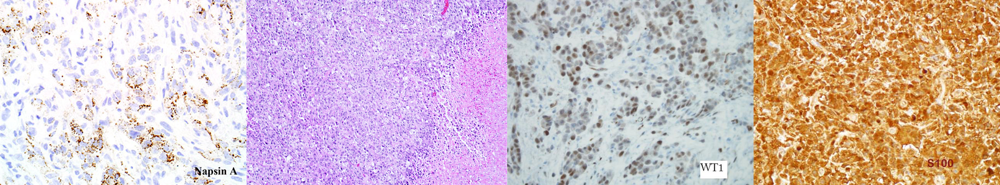

In [13]:
#@title 3) Third Code Cell: Rearrange Images Based on Uploaded Image
!pip install git+git://github.com/jaredwinick/img2vec-keras.git

import numpy as np
import pathlib
import glob
import urllib.request
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns


import sys
sys.path.append("..")  # Adds higher directory to python modules path.

import shutil
from os import path


from img2vec_keras import Img2Vec
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras import preprocessing
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras.utils import Sequence
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K

img2vec = Img2Vec()

image_vectors = {}
image_path_top=image_paths
for fn in uploaded.keys():
  image_path_top.append(fn)
  url_dictionary[fn]='Uploaded from file                  '

for image_path in image_path_top:
  vector = img2vec.get_vec(image_path)
  image_vectors[image_path] = vector


X = np.stack(list(image_vectors.values()))
cos=cosine_similarity(X)




ord=np.argsort(cos[:,-1])[::-1]
ordered_image_list=list()
#print(ord)
#print(cos[:,-1][ord])
for v in ord:
  ordered_image_list.append(list(image_vectors.keys())[v])


display_imgs(ordered_image_list)
